## Latest Netflix TV Shows and Movies

Source: https://www.kaggle.com/datasets/senapatirajesh/netflix-tv-shows-and-movies

In [1]:
import pandas as pd

from lets_plot import *
from lets_plot.mapping import *
from lets_plot.geo_data import *

The geodata is provided by © OpenStreetMap contributors and is made available here under the Open Database License (ODbL).



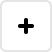
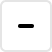
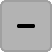
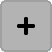
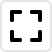
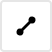
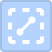
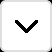
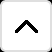
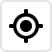

In [2]:
LetsPlot.setup_html()

In [3]:
df = pd.read_csv("data/NetFlix.csv")
df = df[df["release_year"] >= 2000]
print(df.shape)
df.head()

(7338, 12)


,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,genres,description
0,s1,TV Show,3%,NaN,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,14-Aug-20,2020,TV-MA,4,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,s10,Movie,1920,Vikram Bhatt,"Rajneesh Duggal, Adah Sharma, Indraneil Sengup...",India,15-Dec-17,2008,TV-MA,143,"Horror Movies, International Movies, Thrillers",An architect and his wife move into a castle t...
2,s100,Movie,3 Heroines,Iman Brotoseno,"Reza Rahadian, Bunga Citra Lestari, Tara Basro...",Indonesia,05-Jan-19,2016,TV-PG,124,"Dramas, International Movies, Sports Movies",Three Indonesian women break records by becomi...
3,s1000,Movie,Blue Mountain State: The Rise of Thadland,Lev L. Spiro,"Alan Ritchson, Darin Brooks, James Cade, Rob R...",United States,01-Mar-16,2016,R,90,Comedies,New NFL star Thad buys his old teammates' belo...
4,s1001,TV Show,Blue Planet II,NaN,David Attenborough,United Kingdom,03-Dec-18,2017,TV-G,1,"British TV Shows, Docuseries, Science & Nature TV",This sequel to the award-winning nature series...


In [4]:
df.describe(include='all')

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,genres,description
count,7338,7338,7338,5000,6638,6845,7328,7338.000000,7331,7338.000000,7338,7338
unique,7338,2,7338,3825,6411,660,1553,NaN,14,NaN,448,7321
top,s1,Movie,3%,"Raúl Campos, Jan Suter",David Attenborough,United States,01-Jan-20,NaN,TV-MA,NaN,Documentaries,Multiple women report their husbands as missin...
freq,1,4975,1,18,18,2358,84,NaN,2806,NaN,330,3
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015.683701,NaN,67.049741,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.174908,NaN,50.336264,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2000.000000,NaN,1.000000,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2014.000000,NaN,2.000000,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017.000000,NaN,87.000000,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019.000000,NaN,104.750000,NaN,NaN


In [5]:
ggplot(df) + \
    geom_pie(aes(slice='..count..', fill='type'), size=20, \
             labels=layer_labels(['..proppct..']).format('..proppct..', '{.1f}%')) + \
    ggsize(600, 400) + \
    ggtitle("Отношение фильмов к сериалам")

In [6]:
by_genre_df = df["genres"].str.split(", ", expand=True).stack(dropna=True).value_counts()\
    .to_frame("count").reset_index().rename(columns={"index": "genre"})

ggplot(by_genre_df, aes("genre", "count")) + \
    geom_bar(stat='identity') + \
    scale_y_log10() + \
    ggtitle("Количество проектов по жанрам")

In [7]:
ggplot(df, aes(x=as_discrete("rating", order_by='..count..'))) + \
    geom_bar() + \
    scale_y_log10() + \
    ggtitle("Количество проектов по рейтингам")

In [8]:
top_size = 100
cast_top_df = pd.concat([df.country.to_frame(), df.cast.str.split(",", expand=True)], axis='columns')\
    .melt(id_vars=["country"], value_name="name")[["country", "name"]].dropna()\
    .value_counts().to_frame("projects_count").reset_index().iloc[:top_size]
cast_top_df["country_projects_count"] = cast_top_df.groupby("country")["projects_count"].transform('sum')
cast_top_df

ggplot(cast_top_df, aes(x="country")) + \
    geom_pie(aes(fill=as_discrete("name", order_by='..count..'), \
                 weight="projects_count", size="country_projects_count"), \
             show_legend=False, tooltips=layer_tooltips().title("@name")\
                                         .format("@..count..", 'd').line("projects count|@..count..")) + \
    scale_fill_viridis(option='turbo') + \
    scale_size(range=[5, 25]) + \
    ggsize(1000, 400) + \
    ggtitle("Топ {0} актеров".format(top_size)) + \
    theme(axis_title_y='blank', axis_text_y='blank', panel_grid='blank')

In [9]:
by_country_df = df["country"].str.split(", ", expand=True).stack(dropna=True).value_counts()\
    .to_frame("count").reset_index().rename(columns={"index": "country"})
by_country_df = by_country_df[~by_country_df["country"].str.contains(",")]

gdf = geocode_countries(by_country_df["country"]).ignore_all_errors().inc_res(4).get_boundaries()

ggplot() + \
    geom_livemap() + \
    geom_map(aes(fill="count"), data=by_country_df, map=gdf, map_join=["country", "country"], \
             size=0, alpha=.75, show_legend=False, \
             tooltips=layer_tooltips().title("@country").format("@count", 'd').line("projects count|@count")) + \
    scale_fill_gradient(low="#edf8fb", high="#006d2c", trans='log10') + \
    ggtitle("Количество проектов по странам")

In [10]:
gradientn_colors = ["#810f7c", "#8856a7", "#8c96c6", "#b3cde3", "#edf8fb"]
ggplot(df, aes("duration", "release_year")) + \
    geom_area_ridges(aes(fill="..quantile.."), scale=2, \
                     quantiles=[n / 30 for n in range(1, 30)], \
                     sampling=sampling_pick(1000)) + \
    scale_y_continuous(format='{d}') + \
    scale_fill_gradientn(colors=gradientn_colors + list(reversed(gradientn_colors))) + \
    ggsize(800, 600) + \
    ggtitle("Распределение длительности по году релиза")

In [11]:
by_genre_df = pd.melt(
    df["genres"].str.split(", ", expand=True).assign(duration=df["duration"]),
    id_vars=["duration"], value_vars=[0, 1, 2], value_name="genre"
)[["genre", "duration"]].dropna(subset="genre")

ggplot(by_genre_df, aes("duration", "genre")) + \
    geom_area_ridges(aes(fill='..quantile..'), scale=2, sampling=sampling_pick(1000), \
                     quantiles=[0, .01, .1, .25, .5, .75, .9, .99, 1], quantile_lines=True) + \
    scale_x_log10() + \
    scale_fill_viridis(option='plasma') + \
    ggsize(1000, 700) + \
    ggtitle("Распределение длительности по жанрам")